<a href="https://colab.research.google.com/github/arihant-jain-09/AI-pothole-detection/blob/arihant/AI_pothole_detection(Video).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [142]:
!pip install tensorflow-object-detection-api

In [ ]:
!pip install imutils

In [1]:
import numpy as np
import os
import imutils
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile
import cv2

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

print(tf.__version__)

2.9.1


## Env setup

In [2]:
%matplotlib inline

sys.path.append("..")

## Object detection imports

In [3]:
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

In [4]:
cap = cv2.VideoCapture('4.mp4')

# Model preparation 

In [5]:
MODEL_NAME = 'inference_graph'
PATH_TO_CKPT = MODEL_NAME + '/frozen_inference_graph.pb'
PATH_TO_LABELS = 'labelmap.pbtxt'
NUM_CLASSES = 4

## Load a Tensorflow model into memory.

In [6]:
detection_graph = tf.Graph()

with detection_graph.as_default():
    
    od_graph_def = tf.compat.v1.GraphDef()
    with tf.io.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')

## Loading label map

In [7]:
label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(
    label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

## Helper code

In [8]:

def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape(
        (im_height, im_width, 3)).astype(np.uint8)

In [9]:
IMAGE_SIZE = (10, 10)

# Detection

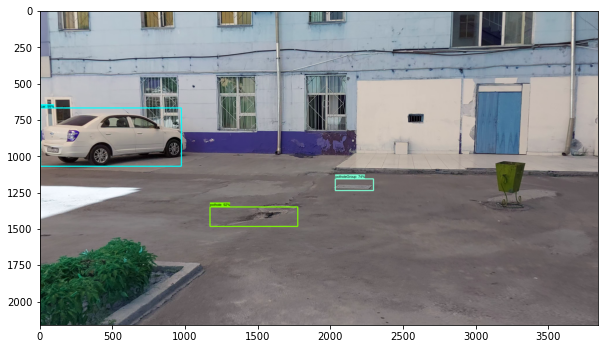

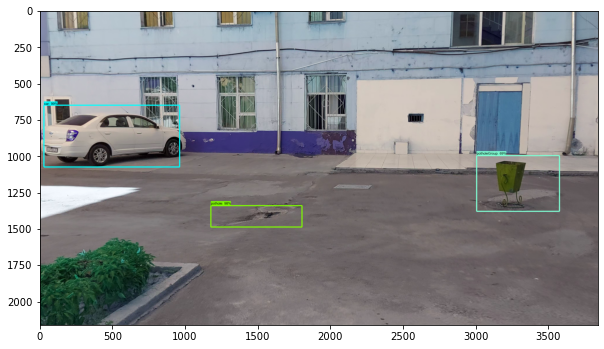

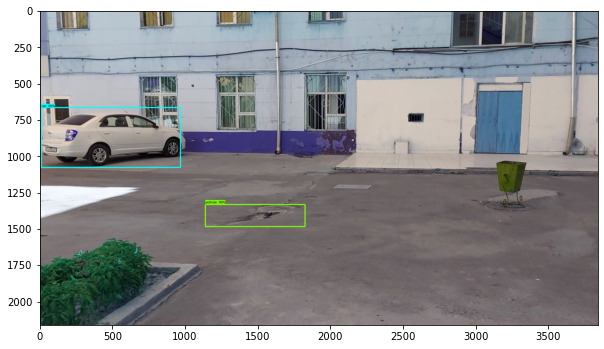

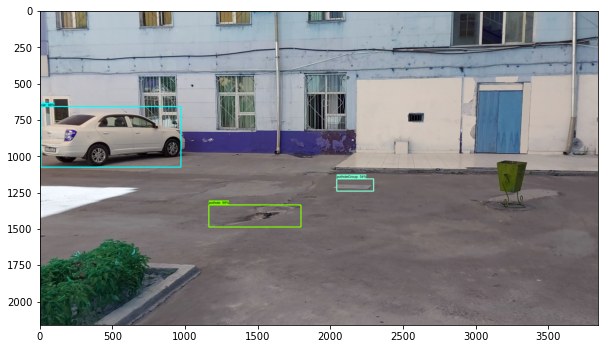

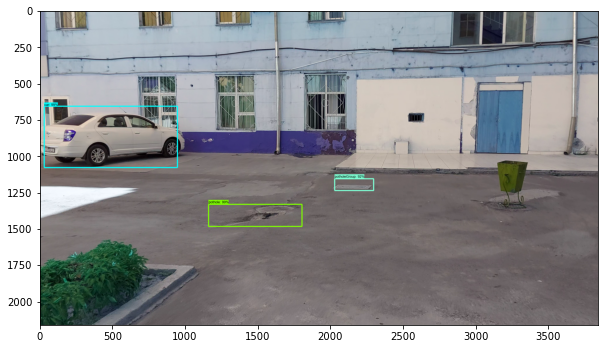

...

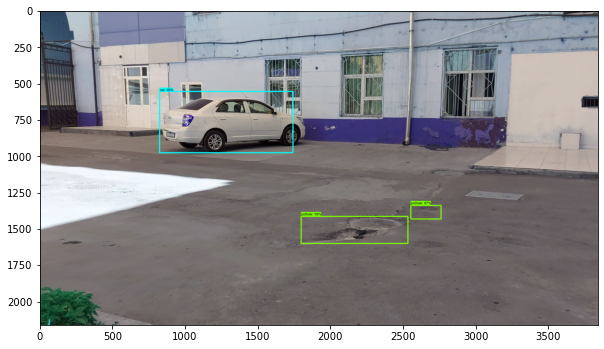

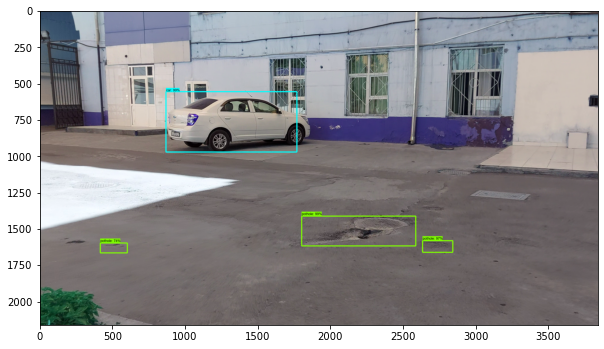

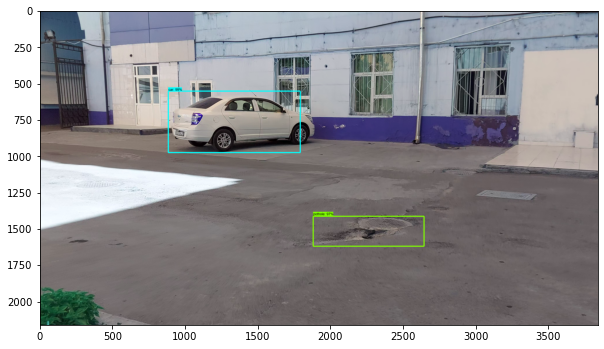

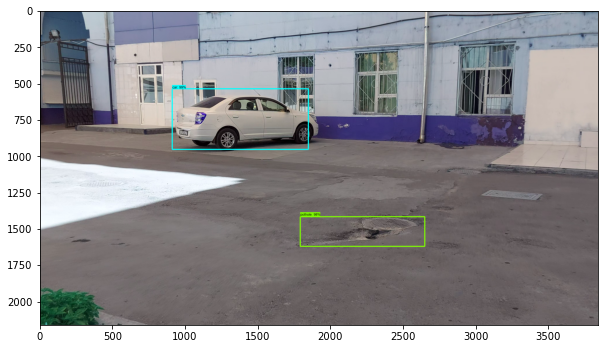

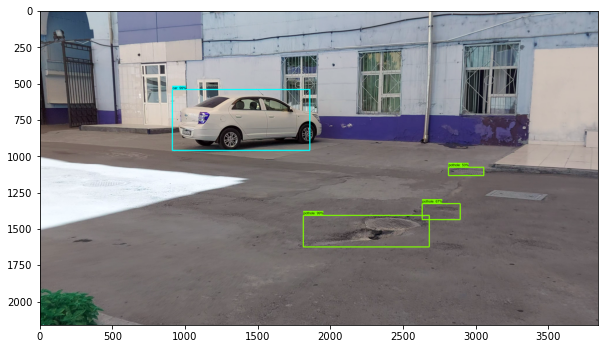

In [ ]:
with detection_graph.as_default():
    with tf.compat.v1.Session(graph=detection_graph) as sess:
        while True:
            ret, image_np = cap.read()
            image_np_expanded = np.expand_dims(image_np, axis=0)
            image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
            boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
            scores = detection_graph.get_tensor_by_name('detection_scores:0')
            classes = detection_graph.get_tensor_by_name('detection_classes:0')
            num_detections = detection_graph.get_tensor_by_name('num_detections:0')

            (boxes, scores, classes, num_detections) = sess.run(
                [boxes, scores, classes, num_detections],
                feed_dict={image_tensor: image_np_expanded})
            
            # Visualization of the results of a detection.
            vis_util.visualize_boxes_and_labels_on_image_array(
                image_np,
                np.squeeze(boxes),
                np.squeeze(classes).astype(np.int32),
                np.squeeze(scores),
                category_index,
                use_normalized_coordinates=True,
                line_thickness=8)
            
            plt.figure(figsize=IMAGE_SIZE)
            plt.imshow(image_np)
            plt.show()
            cv2.waitKey(0)
            if not ret:
                break